# Temperature Forecast project

## Importing Libraries

In [86]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from scipy.stats import zscore
from sklearn.preprocessing import LabelEncoder
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Lasso,Ridge
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import AdaBoostRegressor
from sklearn.svm import SVR
from sklearn.neighbors import KNeighborsRegressor
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import r2_score
from sklearn.model_selection import GridSearchCV
import warnings
warnings.filterwarnings('ignore')

In [2]:
df=pd.read_csv('Temperature Forecast.csv')
df.head()

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,30-06-2013,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,...,0.0,0.0,0.0,37.6046,126.991,212.3350,2.7850,5992.895996,29.1,21.2
1,2.0,30-06-2013,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,...,0.0,0.0,0.0,37.6046,127.032,44.7624,0.5141,5869.312500,30.5,22.5
2,3.0,30-06-2013,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,...,0.0,0.0,0.0,37.5776,127.058,33.3068,0.2661,5863.555664,31.1,23.9
3,4.0,30-06-2013,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,...,0.0,0.0,0.0,37.6450,127.022,45.7160,2.5348,5856.964844,31.7,24.3
4,5.0,30-06-2013,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,...,0.0,0.0,0.0,37.5507,127.135,35.0380,0.5055,5859.552246,31.2,22.5


In [3]:
df.tail()

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
7747,23.0,30-08-2017,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,...,0.000000,0.000000,0.000000,37.5372,126.891,15.5876,0.155400,4443.313965,28.3,18.1
7748,24.0,30-08-2017,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,...,0.000000,0.000000,0.000000,37.5237,126.909,17.2956,0.222300,4438.373535,28.6,18.8
7749,25.0,30-08-2017,23.2,17.4,22.933014,77.243744,27.939516,18.522965,7.289264,9.090034,...,0.000000,0.000000,0.000000,37.5237,126.970,19.5844,0.271300,4451.345215,27.8,17.4
7750,NaN,NaN,20.0,11.3,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,...,0.000000,0.000000,0.000000,37.4562,126.826,12.3700,0.098475,4329.520508,17.4,11.3
7751,NaN,NaN,37.6,29.9,98.524734,100.000153,38.542255,29.619342,21.857621,213.414006,...,21.621661,15.841235,16.655469,37.6450,127.135,212.3350,5.178230,5992.895996,38.9,29.8


## Exploratory Data Analysis

In [4]:
print('The Shape of the dataset is ',df.shape)

The Shape of the dataset is  (7752, 25)


In [5]:
print('The columns of the dataset ',df.columns)

The columns of the dataset  Index(['station', 'Date', 'Present_Tmax', 'Present_Tmin', 'LDAPS_RHmin',
       'LDAPS_RHmax', 'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse', 'LDAPS_WS',
       'LDAPS_LH', 'LDAPS_CC1', 'LDAPS_CC2', 'LDAPS_CC3', 'LDAPS_CC4',
       'LDAPS_PPT1', 'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'lat', 'lon',
       'DEM', 'Slope', 'Solar radiation', 'Next_Tmax', 'Next_Tmin'],
      dtype='object')


In [6]:
print('The number of duplicated rows in the dataset are ',df.duplicated().sum())

The number of duplicated rows in the dataset are  0


In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7752 entries, 0 to 7751
Data columns (total 25 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   station           7750 non-null   float64
 1   Date              7750 non-null   object 
 2   Present_Tmax      7682 non-null   float64
 3   Present_Tmin      7682 non-null   float64
 4   LDAPS_RHmin       7677 non-null   float64
 5   LDAPS_RHmax       7677 non-null   float64
 6   LDAPS_Tmax_lapse  7677 non-null   float64
 7   LDAPS_Tmin_lapse  7677 non-null   float64
 8   LDAPS_WS          7677 non-null   float64
 9   LDAPS_LH          7677 non-null   float64
 10  LDAPS_CC1         7677 non-null   float64
 11  LDAPS_CC2         7677 non-null   float64
 12  LDAPS_CC3         7677 non-null   float64
 13  LDAPS_CC4         7677 non-null   float64
 14  LDAPS_PPT1        7677 non-null   float64
 15  LDAPS_PPT2        7677 non-null   float64
 16  LDAPS_PPT3        7677 non-null   float64


In [8]:
df.dtypes

station             float64
Date                 object
Present_Tmax        float64
Present_Tmin        float64
LDAPS_RHmin         float64
LDAPS_RHmax         float64
LDAPS_Tmax_lapse    float64
LDAPS_Tmin_lapse    float64
LDAPS_WS            float64
LDAPS_LH            float64
LDAPS_CC1           float64
LDAPS_CC2           float64
LDAPS_CC3           float64
LDAPS_CC4           float64
LDAPS_PPT1          float64
LDAPS_PPT2          float64
LDAPS_PPT3          float64
LDAPS_PPT4          float64
lat                 float64
lon                 float64
DEM                 float64
Slope               float64
Solar radiation     float64
Next_Tmax           float64
Next_Tmin           float64
dtype: object

In [9]:
print('The number of null values in the dataset are ')
print(df.isnull().sum())

The number of null values in the dataset are 
station              2
Date                 2
Present_Tmax        70
Present_Tmin        70
LDAPS_RHmin         75
LDAPS_RHmax         75
LDAPS_Tmax_lapse    75
LDAPS_Tmin_lapse    75
LDAPS_WS            75
LDAPS_LH            75
LDAPS_CC1           75
LDAPS_CC2           75
LDAPS_CC3           75
LDAPS_CC4           75
LDAPS_PPT1          75
LDAPS_PPT2          75
LDAPS_PPT3          75
LDAPS_PPT4          75
lat                  0
lon                  0
DEM                  0
Slope                0
Solar radiation      0
Next_Tmax           27
Next_Tmin           27
dtype: int64


In [10]:
df['Date']=df['Date'].fillna(df['Date'].mode()[0])

In [11]:
df['station']=df['station'].fillna(df['station'].median())
df['Present_Tmax']=df['Present_Tmax'].fillna(df['Present_Tmax'].median())
df['Present_Tmin']=df['Present_Tmin'].fillna(df['Present_Tmin'].median())
df['LDAPS_RHmin']=df['LDAPS_RHmin'].fillna(df['LDAPS_RHmin'].median())
df['LDAPS_RHmax']=df['LDAPS_RHmax'].fillna(df['LDAPS_RHmax'].median())
df['LDAPS_Tmax_lapse']=df['LDAPS_Tmax_lapse'].fillna(df['LDAPS_Tmax_lapse'].median())
df['LDAPS_Tmin_lapse']=df['LDAPS_Tmin_lapse'].fillna(df['LDAPS_Tmin_lapse'].median())
df['LDAPS_WS']=df['LDAPS_WS'].fillna(df['LDAPS_WS'].median())
df['LDAPS_LH']=df['LDAPS_LH'].fillna(df['LDAPS_LH'].median())
df['LDAPS_CC1']=df['LDAPS_CC1'].fillna(df['LDAPS_CC1'].median())
df['LDAPS_CC2']=df['LDAPS_CC2'].fillna(df['LDAPS_CC2'].median())
df['LDAPS_CC3']=df['LDAPS_CC3'].fillna(df['LDAPS_CC3'].median())
df['LDAPS_CC4']=df['LDAPS_CC4'].fillna(df['LDAPS_CC4'].median())
df['LDAPS_PPT1']=df['LDAPS_PPT1'].fillna(df['LDAPS_PPT1'].median())
df['LDAPS_PPT2']=df['LDAPS_PPT2'].fillna(df['LDAPS_PPT2'].median())
df['LDAPS_PPT3']=df['LDAPS_PPT3'].fillna(df['LDAPS_PPT3'].median())
df['LDAPS_PPT4']=df['LDAPS_PPT4'].fillna(df['LDAPS_PPT4'].median())
df['Next_Tmax']=df['Next_Tmax'].fillna(df['Next_Tmax'].median())
df['Next_Tmin']=df['Next_Tmin'].fillna(df['Next_Tmin'].median())

In [12]:
df.describe()

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
count,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,...,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000
mean,13.000000,29.769401,23.226638,56.742728,88.388529,29.614317,23.514984,7.092549,62.450457,0.368260,...,0.480310,0.275508,0.266801,37.544722,126.991397,61.867972,1.257048,5341.502803,30.275671,22.932804
std,7.210637,2.956583,2.403093,14.597945,7.158471,2.932911,2.334099,2.173913,33.571540,0.261236,...,1.754900,1.156495,1.200654,0.050352,0.079435,54.279780,1.370444,429.158867,3.122585,2.483296
min,1.000000,20.000000,11.300000,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,0.000000,...,0.000000,0.000000,0.000000,37.456200,126.826000,12.370000,0.098475,4329.520508,17.400000,11.300000
25%,7.000000,27.800000,21.700000,46.046162,84.316923,27.693091,22.114651,5.686487,37.532764,0.148321,...,0.000000,0.000000,0.000000,37.510200,126.937000,28.700000,0.271300,4999.018555,28.200000,21.400000
50%,13.000000,29.900000,23.400000,55.039024,89.793480,29.703426,23.760199,6.547470,56.865482,0.315697,...,0.000000,0.000000,0.000000,37.550700,126.995000,45.716000,0.618000,5436.345215,30.500000,23.100000
75%,19.000000,32.000000,24.900000,67.038254,93.704500,31.683819,25.134000,8.007471,83.904586,0.571696,...,0.016748,0.007231,0.000000,37.577600,127.042000,59.832400,1.767800,5728.316406,32.600000,24.600000
max,25.000000,37.600000,29.900000,98.524734,100.000153,38.542255,29.619342,21.857621,213.414006,0.967277,...,21.621661,15.841235,16.655469,37.645000,127.135000,212.335000,5.178230,5992.895996,38.900000,29.800000


In [13]:
tf=df.drop('Date',axis=1)

In [14]:
tf

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,0.233947,...,0.000000,0.000000,0.000000,37.6046,126.991,212.3350,2.785000,5992.895996,29.1,21.2
1,2.0,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,0.225508,...,0.000000,0.000000,0.000000,37.6046,127.032,44.7624,0.514100,5869.312500,30.5,22.5
2,3.0,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,0.209344,...,0.000000,0.000000,0.000000,37.5776,127.058,33.3068,0.266100,5863.555664,31.1,23.9
3,4.0,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,0.216372,...,0.000000,0.000000,0.000000,37.6450,127.022,45.7160,2.534800,5856.964844,31.7,24.3
4,5.0,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,0.151407,...,0.000000,0.000000,0.000000,37.5507,127.135,35.0380,0.505500,5859.552246,31.2,22.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7747,23.0,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,0.030034,...,0.000000,0.000000,0.000000,37.5372,126.891,15.5876,0.155400,4443.313965,28.3,18.1
7748,24.0,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,0.035874,...,0.000000,0.000000,0.000000,37.5237,126.909,17.2956,0.222300,4438.373535,28.6,18.8
7749,25.0,23.2,17.4,22.933014,77.243744,27.939516,18.522965,7.289264,9.090034,0.048954,...,0.000000,0.000000,0.000000,37.5237,126.970,19.5844,0.271300,4451.345215,27.8,17.4
7750,13.0,20.0,11.3,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,0.000000,...,0.000000,0.000000,0.000000,37.4562,126.826,12.3700,0.098475,4329.520508,17.4,11.3


In [15]:
cat_col=[]
for x in tf.dtypes.index:
    if tf.dtypes[x]=='O':
        cat_col.append(x)
print('The Object Data Type column is ',cat_col)

num_cols=[]
for x in tf.dtypes.index:
    if tf.dtypes[x]=='int64' or tf.dtypes[x]=='float64':
        num_cols.append(x)
print('The Numerical Columns are ',num_cols)

The Object Data Type column is  []
The Numerical Columns are  ['station', 'Present_Tmax', 'Present_Tmin', 'LDAPS_RHmin', 'LDAPS_RHmax', 'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse', 'LDAPS_WS', 'LDAPS_LH', 'LDAPS_CC1', 'LDAPS_CC2', 'LDAPS_CC3', 'LDAPS_CC4', 'LDAPS_PPT1', 'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'lat', 'lon', 'DEM', 'Slope', 'Solar radiation', 'Next_Tmax', 'Next_Tmin']


## Data Visualization

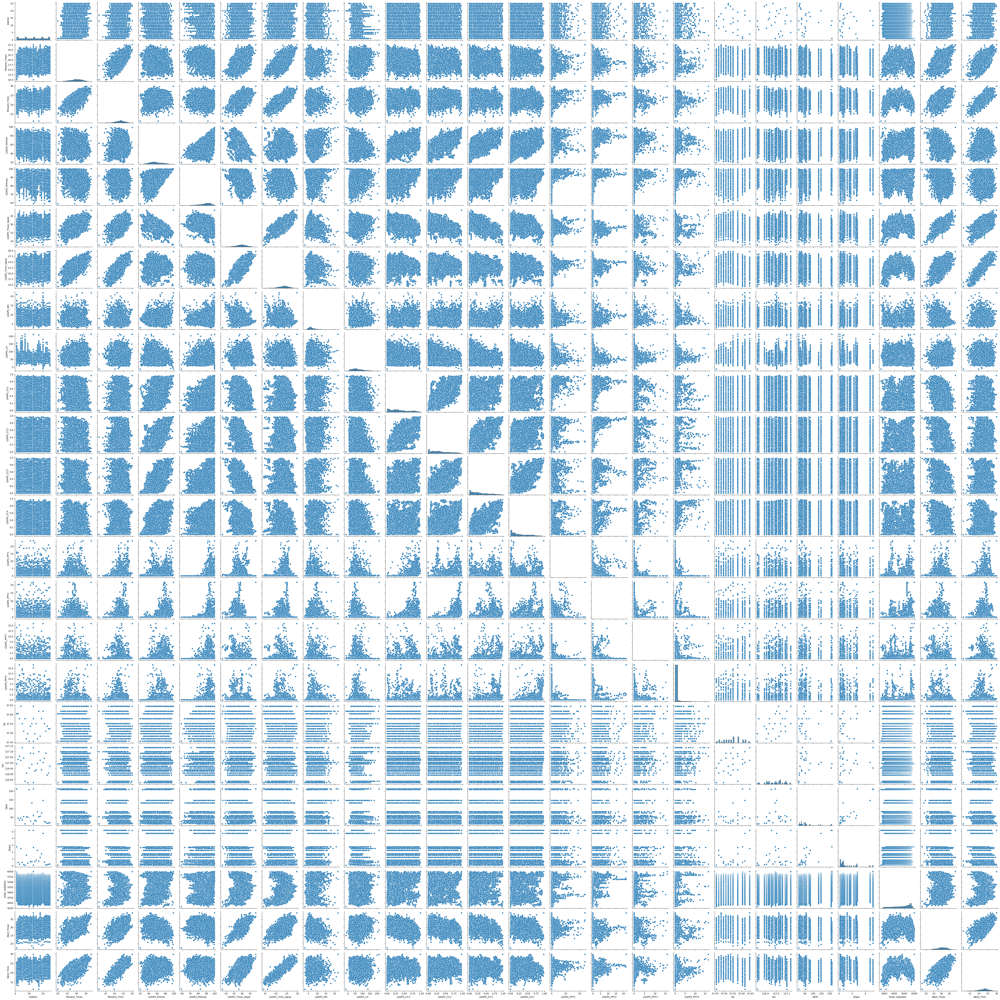

In [16]:
sns.pairplot(tf)

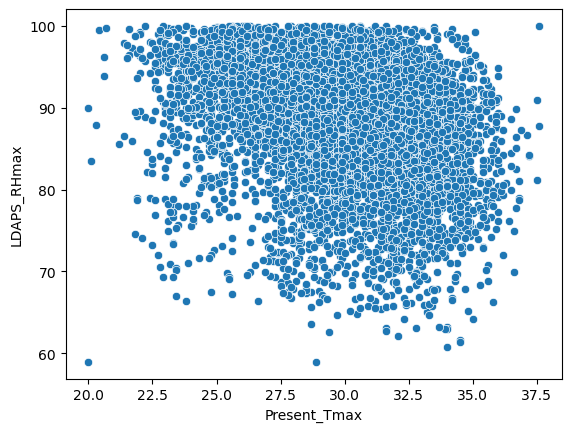

In [17]:
sns.scatterplot(x=tf['Present_Tmax'],y=tf['LDAPS_RHmax'],data=tf)
plt.show()

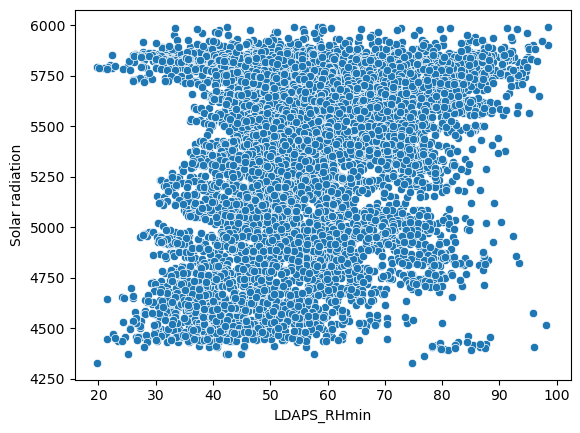

In [18]:
sns.scatterplot(x=tf['LDAPS_RHmin'],y=tf['Solar radiation'],data=tf)
plt.show()

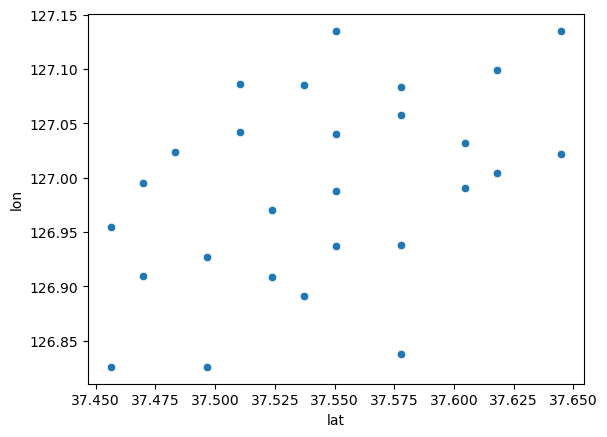

In [19]:
sns.scatterplot(x=tf['lat'],y=tf['lon'],data=tf)
plt.show()

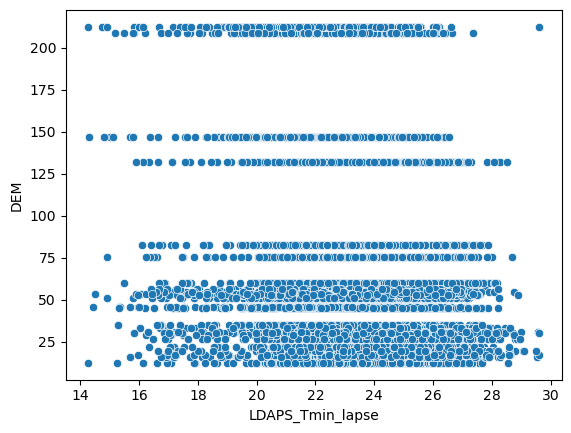

In [20]:
sns.scatterplot(x=tf['LDAPS_Tmin_lapse'],y=tf['DEM'],data=tf)
plt.show()

## Detecting Outliers

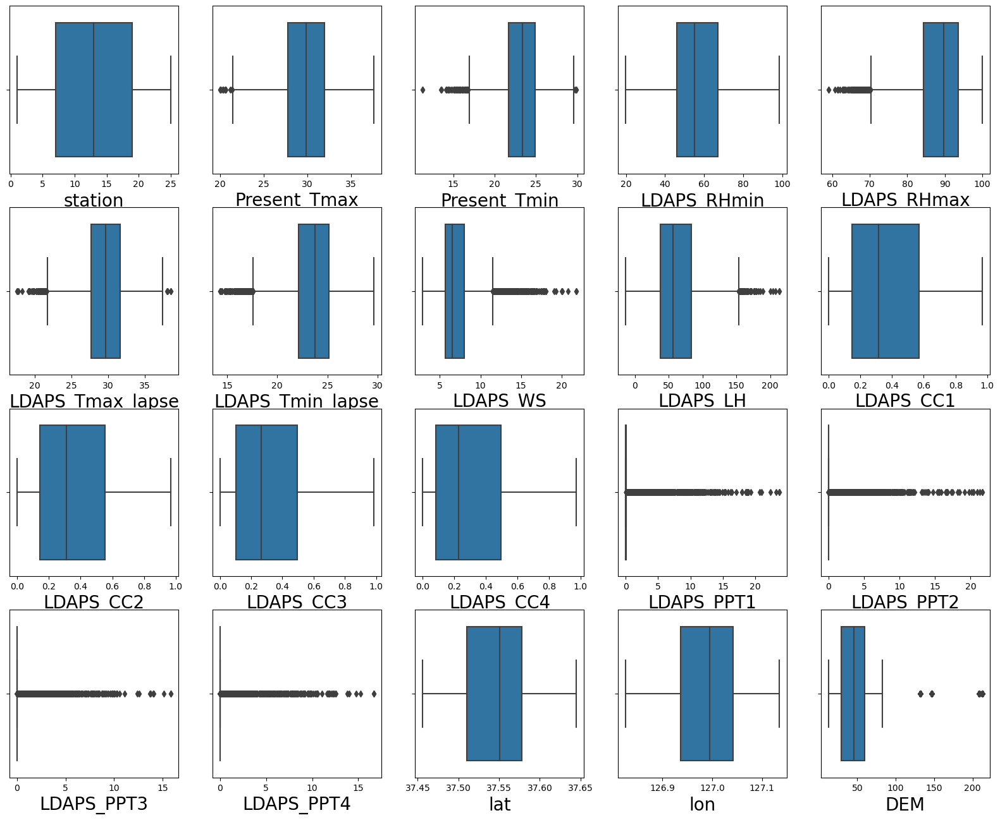

In [26]:
plt.figure(figsize=(20,20))
p=1

for col in tf[num_cols]:
    if p<=20:
        ax=plt.subplot(5,5,p)
        sns.boxplot(tf[col])
        plt.xlabel(col,fontsize=20)
    p+=1
    
plt.show()

## Detecting Skewness

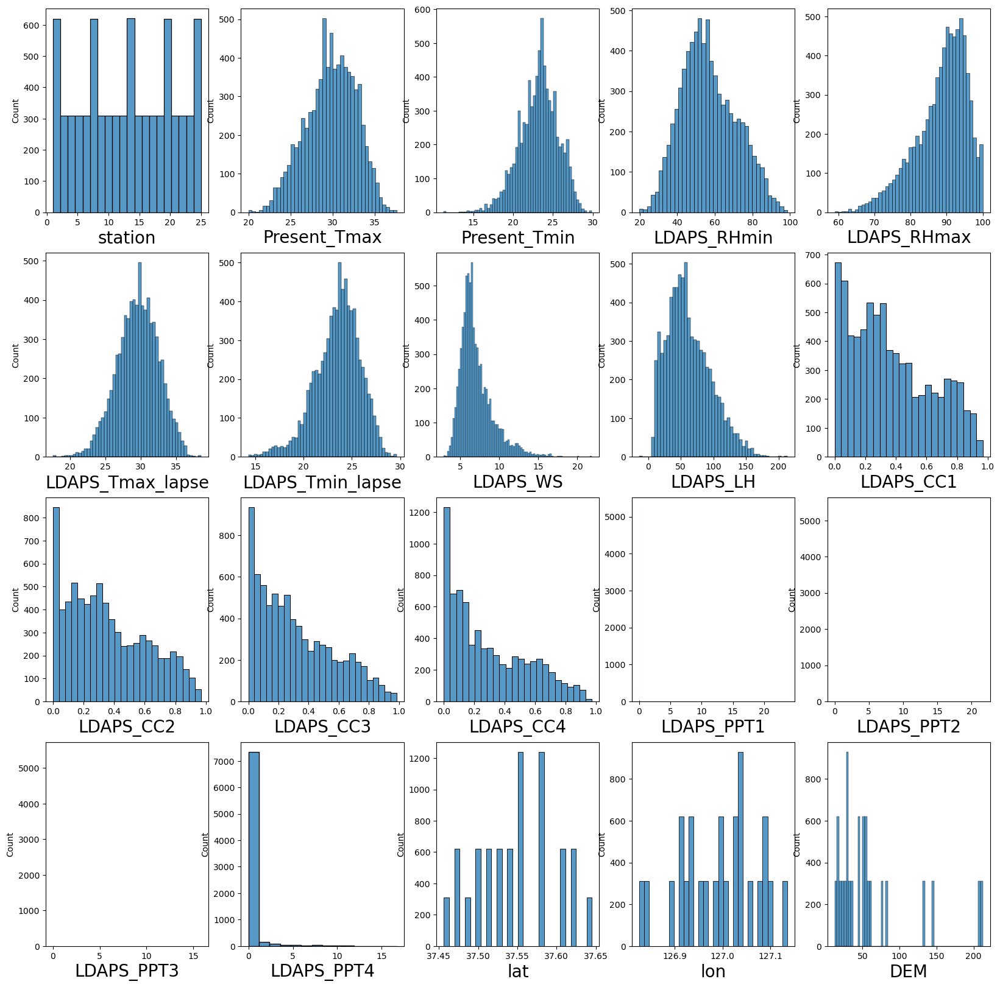

In [22]:
plt.figure(figsize=(20,20))
p=1

for col in tf[num_cols]:
    if p<=20:
        ax=plt.subplot(4,5,p)
        sns.histplot(tf[col])
        plt.xlabel(col,fontsize=20)
    p+=1
    
plt.show()

## Removing Outliers Using Z-Score

In [27]:
z=np.abs(zscore(tf))
z

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.664315,0.361725,0.760169,0.103649,0.381088,0.525183,0.217678,0.125893,0.208564,0.514175,...,0.273714,0.238242,0.222227,1.189286,0.005000,2.772243,1.115004,1.517935,0.376530,0.697829
1,1.525622,0.720675,0.676937,0.306866,0.309610,0.080598,0.222809,0.644345,0.313173,0.546482,...,0.273714,0.238242,0.222227,1.189286,0.511177,0.315157,0.542158,1.229950,0.071845,0.174298
2,1.386929,0.619200,0.030530,0.551637,0.616784,0.162639,0.450160,0.439018,1.247488,0.608363,...,0.273714,0.238242,0.222227,0.653021,0.838510,0.526218,0.723133,1.216534,0.264006,0.389506
3,1.248236,0.754500,0.072146,0.102559,1.130923,0.030795,0.080896,0.663593,0.097609,0.581458,...,0.273714,0.238242,0.222227,1.991696,0.385280,0.297588,0.932424,1.201176,0.456167,0.550592
4,1.109544,0.551550,0.552090,0.038955,0.246800,0.170621,0.012213,0.624511,1.355851,0.830157,...,0.273714,0.238242,0.222227,0.118743,1.807917,0.494322,0.548433,1.207205,0.296033,0.174298
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7747,1.386929,2.188275,2.549645,2.055314,1.329793,1.112358,2.030596,0.434099,0.286208,1.294796,...,0.273714,0.238242,0.222227,0.149390,1.263971,0.852681,0.803915,2.093040,0.632744,1.946251
7748,1.525622,2.188275,2.299950,2.240329,1.549810,0.887955,2.048660,0.252892,0.453062,1.272440,...,0.273714,0.238242,0.222227,0.417522,1.037356,0.821213,0.755095,2.104553,0.536664,1.664349
7749,1.664315,2.222100,2.424798,2.316209,1.556967,0.571074,2.138873,0.090494,1.589557,1.222369,...,0.273714,0.238242,0.222227,0.417522,0.269384,0.779043,0.719338,2.074325,0.792878,2.228152
7750,0.000000,3.304501,4.963357,2.531209,4.114586,4.088135,3.959959,1.936712,2.265567,1.409773,...,0.273714,0.238242,0.222227,1.758184,2.082302,0.911963,0.845455,2.358212,4.123667,4.684723


In [28]:
np.where(z>3)

(array([  25,   25,   26, ..., 7751, 7751, 7751], dtype=int64),
 array([ 7, 14, 14, ..., 14, 15, 16], dtype=int64))

In [29]:
temp=tf[(z<3).all(axis=1)]
temp

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,0.233947,...,0.0,0.0,0.0,37.6046,126.991,212.3350,2.7850,5992.895996,29.1,21.2
1,2.0,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,0.225508,...,0.0,0.0,0.0,37.6046,127.032,44.7624,0.5141,5869.312500,30.5,22.5
2,3.0,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,0.209344,...,0.0,0.0,0.0,37.5776,127.058,33.3068,0.2661,5863.555664,31.1,23.9
3,4.0,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,0.216372,...,0.0,0.0,0.0,37.6450,127.022,45.7160,2.5348,5856.964844,31.7,24.3
4,5.0,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,0.151407,...,0.0,0.0,0.0,37.5507,127.135,35.0380,0.5055,5859.552246,31.2,22.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7745,21.0,23.1,17.8,24.688997,78.261383,27.812697,18.303014,6.603253,9.614074,0.052902,...,0.0,0.0,0.0,37.5507,127.040,26.2980,0.5721,4456.024414,27.6,17.7
7746,22.0,22.5,17.4,30.094858,83.690018,26.704905,17.814038,5.768083,82.146707,0.066461,...,0.0,0.0,0.0,37.5102,127.086,21.9668,0.1332,4441.803711,28.0,17.1
7747,23.0,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,0.030034,...,0.0,0.0,0.0,37.5372,126.891,15.5876,0.1554,4443.313965,28.3,18.1
7748,24.0,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,0.035874,...,0.0,0.0,0.0,37.5237,126.909,17.2956,0.2223,4438.373535,28.6,18.8


In [35]:
print('Data Loss Percentage After Removing Outliers using Z-Score ',((tf.shape[0]-temp.shape[0])/tf.shape[0])*100)

Data Loss Percentage After Removing Outliers using Z-Score  11.06811145510836


## Removing Outliers Using IQR Method

In [31]:
Q1=tf.quantile(0.25)
Q3=tf.quantile(0.75)
IQR=Q3-Q1
temp1=tf[~((tf<(Q1-1.5*IQR))|(tf>(Q3+1.5*IQR))).any(axis=1)]

In [36]:
print('Data Loss Percentage After Removing Outliers using IQR Method ',((tf.shape[0]-temp1.shape[0])/tf.shape[0])*100)

Data Loss Percentage After Removing Outliers using IQR Method  58.320433436532504


## Correlation

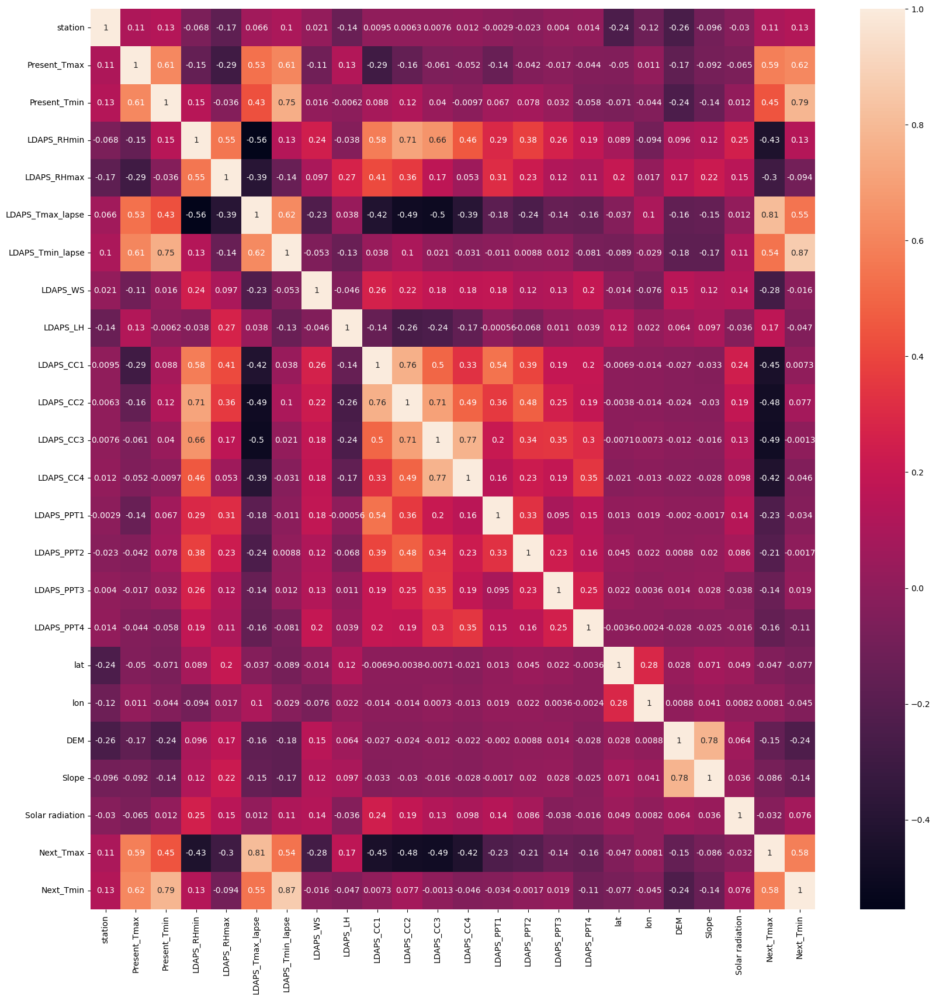

In [44]:
plt.figure(figsize=(20,20))
sns.heatmap(temp.corr(),annot=True)
plt.show()

## Feature Selection for Predicting Next_Tmin

In [45]:
x=temp.drop('Next_Tmin',axis=1)
y=temp['Next_Tmin']

In [50]:
x

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,...,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax
0,-1.671954,-0.434050,-0.829175,0.192637,0.434015,-0.662061,-0.291984,0.090745,0.452403,-0.383698,...,-0.4003,-0.338544,-0.303285,-0.274861,1.214518,0.002256,2.091063,1.333306,1.552067,-0.499372
1,-1.533039,0.687149,-0.742467,-0.240864,0.359993,-0.012462,0.172135,-0.617539,-0.015983,-0.421605,...,-0.4003,-0.338544,-0.303285,-0.274861,1.214518,0.516874,-0.026657,-0.501163,1.257875,-0.021986
2,-1.394124,0.582037,-0.005452,-0.499340,-0.599376,0.075514,0.411682,-0.323717,-1.487042,-0.494945,...,-0.4003,-0.338544,-0.303285,-0.274861,0.674104,0.843217,-0.423016,-0.859318,1.244171,0.182608
3,-1.255209,0.722187,0.037902,0.191486,1.210540,-0.065867,-0.147864,-0.646080,0.363391,-0.462937,...,-0.4003,-0.338544,-0.303285,-0.274861,2.023139,0.391357,0.001715,1.196377,1.228481,0.387202
4,-1.116295,0.511962,-0.612406,0.042048,0.294947,-0.281852,-0.075496,-0.588315,1.167071,-0.766112,...,-0.4003,-0.338544,-0.303285,-0.274861,0.135691,1.809694,-0.355291,-0.512568,1.234641,0.216707
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6889,1.106341,-2.396149,-2.389912,-2.235680,-1.425797,-0.757642,-2.415547,-0.036517,-2.649355,-1.260103,...,-0.4003,-0.338544,-0.303285,-0.274861,0.135691,0.617287,-0.737400,-0.425898,-2.106479,-1.010857
6890,1.245255,-2.606374,-2.563327,-1.844604,-0.640401,-1.162701,-2.636293,-0.566019,0.723909,-1.189427,...,-0.4003,-0.338544,-0.303285,-0.274861,-0.674931,1.194663,-0.975067,-1.081354,-2.140332,-0.874461
6891,1.384170,-2.326074,-2.693388,-2.087210,-1.337765,-1.291709,-2.202165,-0.316905,0.511938,-1.381390,...,-0.4003,-0.338544,-0.303285,-0.274861,-0.134517,-1.252910,-1.422705,-1.042509,-2.136737,-0.772164
6892,1.523085,-2.326074,-2.433266,-2.282585,-1.565613,-1.051074,-2.221197,-0.072832,-0.168211,-1.350164,...,-0.4003,-0.338544,-0.303285,-0.274861,-0.404724,-1.026980,-1.287882,-0.929809,-2.148498,-0.669867


## Removing Skewness Using Log Transform

In [46]:
for col in x:
    if x.skew().loc[col]>0.55:
        x[col]=np.log1p(x[col])

## Scaling The Features

In [57]:
scaler=StandardScaler()
x=pd.DataFrame(scaler.fit_transform(x),columns=x.columns)
x

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,...,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax
0,-1.671954,-0.434050,-0.829175,0.192637,0.434015,-0.662061,-0.291984,0.090745,0.452417,-0.383698,...,-0.4003,-0.338544,-0.303285,-0.274861,1.214518,0.002256,2.091063,1.333306,1.552067,-0.499372
1,-1.533039,0.687149,-0.742467,-0.240864,0.359993,-0.012462,0.172135,-0.617539,-0.016003,-0.421605,...,-0.4003,-0.338544,-0.303285,-0.274861,1.214518,0.516874,-0.026657,-0.501163,1.257875,-0.021986
2,-1.394124,0.582037,-0.005452,-0.499340,-0.599376,0.075514,0.411682,-0.323717,-1.487167,-0.494945,...,-0.4003,-0.338544,-0.303285,-0.274861,0.674104,0.843217,-0.423016,-0.859318,1.244171,0.182608
3,-1.255209,0.722187,0.037902,0.191486,1.210540,-0.065867,-0.147864,-0.646080,0.363398,-0.462937,...,-0.4003,-0.338544,-0.303285,-0.274861,2.023139,0.391357,0.001715,1.196377,1.228481,0.387202
4,-1.116295,0.511962,-0.612406,0.042048,0.294947,-0.281852,-0.075496,-0.588315,1.167135,-0.766112,...,-0.4003,-0.338544,-0.303285,-0.274861,0.135691,1.809694,-0.355291,-0.512568,1.234641,0.216707
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6889,1.106341,-2.396149,-2.389912,-2.235680,-1.425797,-0.757642,-2.415547,-0.036517,-2.649562,-1.260103,...,-0.4003,-0.338544,-0.303285,-0.274861,0.135691,0.617287,-0.737400,-0.425898,-2.106479,-1.010857
6890,1.245255,-2.606374,-2.563327,-1.844604,-0.640401,-1.162701,-2.636293,-0.566019,0.723942,-1.189427,...,-0.4003,-0.338544,-0.303285,-0.274861,-0.674931,1.194663,-0.975067,-1.081354,-2.140332,-0.874461
6891,1.384170,-2.326074,-2.693388,-2.087210,-1.337765,-1.291709,-2.202165,-0.316905,0.511955,-1.381390,...,-0.4003,-0.338544,-0.303285,-0.274861,-0.134517,-1.252910,-1.422705,-1.042509,-2.136737,-0.772164
6892,1.523085,-2.326074,-2.433266,-2.282585,-1.565613,-1.051074,-2.221197,-0.072832,-0.168242,-1.350164,...,-0.4003,-0.338544,-0.303285,-0.274861,-0.404724,-1.026980,-1.287882,-0.929809,-2.148498,-0.669867


In [58]:
vif=pd.DataFrame()
vif['Features']=x.columns
vif['Values']=[variance_inflation_factor(x.values,i) for i in range(len(x.columns))]
vif

,Features,Values
0,station,1.293282
1,Present_Tmax,2.804454
2,Present_Tmin,3.023182
3,LDAPS_RHmin,5.946702
4,LDAPS_RHmax,2.238569
5,LDAPS_Tmax_lapse,8.100334
6,LDAPS_Tmin_lapse,6.750362
7,LDAPS_WS,1.229156
8,LDAPS_LH,1.506427
9,LDAPS_CC1,3.734778


## Finding best random state to build our Regression model

In [59]:
maxAcc=0
maxRs=0
for i in range(1000):
    x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.30,random_state=i)
    lr=LinearRegression()
    lr.fit(x_train,y_train)
    pred=lr.predict(x_test)
    ac=r2_score(y_test,pred)
    if ac>maxAcc:
        maxAcc=ac
        Rs=i
        
print('Best Score ',maxAcc)
print('Best Random State ',Rs)

Best Score  0.8528349800933128
Best Random State  717


## Splitting The Model

In [60]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.30,random_state=717)

In [61]:
print('Size of x_train :',x_train.shape)
print('Size of x_test :',x_test.shape)
print('Size of y_train :',y_train.shape)
print('Size of y_test :',y_test.shape)

Size of x_train : (4825, 23)
Size of x_test : (2069, 23)
Size of y_train : (4825,)
Size of y_test : (2069,)


In [62]:
def classify(clf,x,y):
    x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.30,random_state=717)
    clf.fit(x_train,y_train)
    pred=clf.predict(x_test)
    MAE=mean_absolute_error(y_test,pred)
    print('The Mean Absolute Error ',MAE)
    MSE=mean_squared_error(y_test,pred)
    print('The Mean Squared Error ',MSE)
    Accuracy_Score=r2_score(y_test,pred)*100
    print('R2 Score ',Accuracy_Score)

## Linear Regression

In [63]:
clf=LinearRegression()
classify(clf,x,y)

The Mean Absolute Error  0.735605436262332
The Mean Squared Error  0.8595200496944111
R2 Score  85.28349800933128


## Decision Tree Regressor

In [65]:
clf=DecisionTreeRegressor()
classify(clf,x,y)

The Mean Absolute Error  0.8280328661188981
The Mean Squared Error  1.2296858385693572
R2 Score  78.94560563463638


## Random Forest Classifier

In [66]:
clf=RandomForestRegressor()
classify(clf,x,y)

The Mean Absolute Error  0.5759091348477525
The Mean Squared Error  0.552760639922668
R2 Score  90.53576113707014


## Gradient Boosting Regressor

In [67]:
clf=GradientBoostingRegressor()
classify(clf,x,y)

The Mean Absolute Error  0.612220109006505
The Mean Squared Error  0.5972674866957145
R2 Score  89.77372527837574


## Lasso

In [68]:
clf=Lasso()
classify(clf,x,y)

The Mean Absolute Error  1.2610470261254192
The Mean Squared Error  2.4711772227987696
R2 Score  57.689079467613325


## Ridge

In [69]:
clf=Ridge()
classify(clf,x,y)

The Mean Absolute Error  0.7356236675314259
The Mean Squared Error  0.8595721760906936
R2 Score  85.28260551332153


## KNeighbors Regressor

In [70]:
clf=KNeighborsRegressor()
classify(clf,x,y)

The Mean Absolute Error  0.6963557274045431
The Mean Squared Error  0.8362443692605123
R2 Score  85.68201878561966


## Support Vector Regressor

In [71]:
clf=SVR(kernel='linear')
classify(clf,x,y)

The Mean Absolute Error  0.7332306597762559
The Mean Squared Error  0.867588173425381
R2 Score  85.14535747498309


In [72]:
clf=SVR(kernel='poly')
classify(clf,x,y)

The Mean Absolute Error  0.7051559558984004
The Mean Squared Error  0.8285450212835141
R2 Score  85.81384522744685


In [73]:
clf=SVR(kernel='rbf')
classify(clf,x,y)

The Mean Absolute Error  0.5572632662320486
The Mean Squared Error  0.5185447572628469
R2 Score  91.12159750639599


## Ada Boost Regressor

In [74]:
clf=AdaBoostRegressor()
classify(clf,x,y)

The Mean Absolute Error  0.859649903013865
The Mean Squared Error  1.1103133360111386
R2 Score  80.98947380519704


## XG Boost Regressor

In [88]:
clf=XGBRegressor()
classify(clf,x,y)

The Mean Absolute Error  0.48445828946216374
The Mean Squared Error  0.4080393029885299
R2 Score  93.01364614259234


From the above evaluation Metrics, We can clearly see that XG Boost Regressor is giving best R2 score and least MSE and MAE so selecting Ridge Regressor as our final model

In [92]:
xg=XGBRegressor()
xg.fit(x_train,y_train)
pred=xg.predict(x_test)
MAE=mean_absolute_error(y_test,pred)
print('The Mean Absolute Error ',MAE)
MSE=mean_squared_error(y_test,pred)
print('The Mean Squared Error ',MSE)
Accuracy_Score=r2_score(y_test,pred)*100
print('R2 Score ',Accuracy_Score)

The Mean Absolute Error  0.48445828946216374
The Mean Squared Error  0.4080393029885299
R2 Score  93.01364614259234


## Hyper Parameter Tuning for finding Best Parameter

In [93]:
params={'max_depth':[2,4,6],
       'n_estimators':[100,500,1000],
       'colsample_bytree':[0.2,0.6,0.8],
       'min_child_weight':[3,5,7],
       'gamma':[0.3,0.5,0.7],
       'subsample':[0.4,0.6,0.8]}
model=XGBRegressor()
grid=GridSearchCV(estimator=model,param_grid=params,scoring='r2',verbose=1)
grid.fit(x_train,y_train)

Fitting 5 folds for each of 729 candidates, totalling 3645 fits


GridSearchCV(estimator=XGBRegressor(base_score=None, booster=None,
                                    callbacks=None, colsample_bylevel=None,
                                    colsample_bynode=None,
                                    colsample_bytree=None, device=None,
                                    early_stopping_rounds=None,
                                    enable_categorical=False, eval_metric=None,
                                    feature_types=None, gamma=None,
                                    grow_policy=None, importance_type=None,
                                    interaction_constraints=None,
                                    learning_rate=None, max_bi...
                                    min_child_weight=None, missing=nan,
                                    monotone_constraints=None,
                                    multi_strategy=None, n_estimators=None,
                                    n_jobs=None, num_parallel_tree=None,
                      

In [95]:
print('The Best Score is ',grid.best_score_)
print('The Best parameter is',grid.best_params_)

The Best Score is  0.9177327037947155
The Best parameter is {'colsample_bytree': 0.8, 'gamma': 0.3, 'max_depth': 4, 'min_child_weight': 7, 'n_estimators': 1000, 'subsample': 0.8}


In [96]:
xg_final=XGBRegressor(colsample_bytree=0.8,gamma=0.3,max_depth=4,min_child_weight=7,n_estimators=1000,subsample=0.8)
xg_final.fit(x_train,y_train)
pred_xg=xg_final.predict(x_test)
MAE=mean_absolute_error(y_test,pred_xg)
print('The Mean Absolute Error ',MAE)
MSE=mean_squared_error(y_test,pred_xg)
print('The Mean Squared Error ',MSE)
Accuracy_Score=r2_score(y_test,pred_xg)*100
print('R2 Score ',Accuracy_Score)

The Mean Absolute Error  0.4743567422947024
The Mean Squared Error  0.38011823042028886
R2 Score  93.49170424045545


## Saving The Model

In [97]:
import pickle

In [99]:
filename='Temperature Forecast Next_Tmin.pkl'
pickle.dump(xg,open(filename,'wb'))
loaded_model=pickle.load(open('Temperature Forecast Next_Tmin.pkl','rb'))
result=loaded_model.score(x_test,y_test)
print(result*100)

93.01364614259234


In [100]:
conclusion=pd.DataFrame([loaded_model.predict(x_test)[:],pred[:]],index=['Predicted','Original'])
conclusion

,0,1,2,3,4,5,6,7,8,9,...,2059,2060,2061,2062,2063,2064,2065,2066,2067,2068
Predicted,25.08115,27.43301,18.647467,18.849804,22.31636,18.261848,21.698919,23.612188,23.92366,25.037214,...,19.696552,21.52318,24.234413,20.619513,20.558699,24.381239,23.135004,28.163822,25.060282,23.171722
Original,25.08115,27.43301,18.647467,18.849804,22.31636,18.261848,21.698919,23.612188,23.92366,25.037214,...,19.696552,21.52318,24.234413,20.619513,20.558699,24.381239,23.135004,28.163822,25.060282,23.171722


## Feature Selection For Predicting Next_Tmax

In [101]:
X=temp.drop('Next_Tmax',axis=1)
Y=temp['Next_Tmax']

## Removing Skewness Using Log Transform

In [102]:
for col in X:
    if X.skew().loc[col]>0.55:
        X[col]=np.log1p(X[col])

## Scaling the features

In [108]:
Scaler=StandardScaler()
X=pd.DataFrame(Scaler.fit_transform(X),columns=X.columns)
X

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,...,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmin
0,-1.671954,-0.434050,-0.829175,0.192637,0.434015,-0.662061,-0.291984,0.090745,0.452417,-0.383698,...,-0.4003,-0.338544,-0.303285,-0.274861,1.214518,0.002256,2.091063,1.333306,1.552067,-0.801078
1,-1.533039,0.687149,-0.742467,-0.240864,0.359993,-0.012462,0.172135,-0.617539,-0.016003,-0.421605,...,-0.4003,-0.338544,-0.303285,-0.274861,1.214518,0.516874,-0.026657,-0.501163,1.257875,-0.248632
2,-1.394124,0.582037,-0.005452,-0.499340,-0.599376,0.075514,0.411682,-0.323717,-1.487167,-0.494945,...,-0.4003,-0.338544,-0.303285,-0.274861,0.674104,0.843217,-0.423016,-0.859318,1.244171,0.346310
3,-1.255209,0.722187,0.037902,0.191486,1.210540,-0.065867,-0.147864,-0.646080,0.363398,-0.462937,...,-0.4003,-0.338544,-0.303285,-0.274861,2.023139,0.391357,0.001715,1.196377,1.228481,0.516293
4,-1.116295,0.511962,-0.612406,0.042048,0.294947,-0.281852,-0.075496,-0.588315,1.167135,-0.766112,...,-0.4003,-0.338544,-0.303285,-0.274861,0.135691,1.809694,-0.355291,-0.512568,1.234641,-0.248632
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6889,1.106341,-2.396149,-2.389912,-2.235680,-1.425797,-0.757642,-2.415547,-0.036517,-2.649562,-1.260103,...,-0.4003,-0.338544,-0.303285,-0.274861,0.135691,0.617287,-0.737400,-0.425898,-2.106479,-2.288433
6890,1.245255,-2.606374,-2.563327,-1.844604,-0.640401,-1.162701,-2.636293,-0.566019,0.723942,-1.189427,...,-0.4003,-0.338544,-0.303285,-0.274861,-0.674931,1.194663,-0.975067,-1.081354,-2.140332,-2.543409
6891,1.384170,-2.326074,-2.693388,-2.087210,-1.337765,-1.291709,-2.202165,-0.316905,0.511955,-1.381390,...,-0.4003,-0.338544,-0.303285,-0.274861,-0.134517,-1.252910,-1.422705,-1.042509,-2.136737,-2.118450
6892,1.523085,-2.326074,-2.433266,-2.282585,-1.565613,-1.051074,-2.221197,-0.072832,-0.168242,-1.350164,...,-0.4003,-0.338544,-0.303285,-0.274861,-0.404724,-1.026980,-1.287882,-0.929809,-2.148498,-1.820979


In [109]:
Vif=pd.DataFrame()
Vif['Features']=X.columns
Vif['Values']=[variance_inflation_factor(X.values,i) for i in range(len(X.columns))]
Vif

,Features,Values
0,station,1.283690
1,Present_Tmax,2.730061
2,Present_Tmin,3.285239
3,LDAPS_RHmin,5.986162
4,LDAPS_RHmax,2.238738
5,LDAPS_Tmax_lapse,6.911935
6,LDAPS_Tmin_lapse,8.337278
7,LDAPS_WS,1.212874
8,LDAPS_LH,1.479753
9,LDAPS_CC1,3.729556


## Finding best random state to build our Regression model

In [110]:
maxAcc=0
maxRs=0
for i in range(1000):
    x_train,x_test,y_train,y_test=train_test_split(X,Y,test_size=0.30,random_state=i)
    lr=LinearRegression()
    lr.fit(x_train,y_train)
    pred=lr.predict(x_test)
    ac=r2_score(y_test,pred)
    if ac>maxAcc:
        maxAcc=ac
        Rs=i
        
print('Best Score ',maxAcc)
print('Best Random State ',Rs)

Best Score  0.7979841526290945
Best Random State  938


## Splitting the model

In [114]:
x_train,x_test,y_train,y_test=train_test_split(X,Y,test_size=0.30,random_state=938)

In [115]:
print('Size of x_train :',x_train.shape)
print('Size of x_test :',x_test.shape)
print('Size of y_train :',y_train.shape)
print('Size of y_test :',y_test.shape)

Size of x_train : (4825, 23)
Size of x_test : (2069, 23)
Size of y_train : (4825,)
Size of y_test : (2069,)


In [116]:
def classify(clf,x,y):
    x_train,x_test,y_train,y_test=train_test_split(X,Y,test_size=0.30,random_state=938)
    clf.fit(x_train,y_train)
    pred=clf.predict(x_test)
    MAE=mean_absolute_error(y_test,pred)
    print('The Mean Absolute Error ',MAE)
    MSE=mean_squared_error(y_test,pred)
    print('The Mean Squared Error ',MSE)
    Accuracy_Score=r2_score(y_test,pred)*100
    print('R2 Score ',Accuracy_Score)

## Linear Regression

In [117]:
clf=LinearRegression()
classify(clf,x,y)

The Mean Absolute Error  0.9964612166639673
The Mean Squared Error  1.7258915606493614
R2 Score  79.79841526290944


## Decision Tree Regressor

In [118]:
clf=DecisionTreeRegressor()
classify(clf,x,y)

The Mean Absolute Error  1.016384726921218
The Mean Squared Error  2.0197825036249393
R2 Score  76.35841768522225


## Random Forest Regressor

In [119]:
clf=RandomForestRegressor()
classify(clf,x,y)

The Mean Absolute Error  0.6957491541807633
The Mean Squared Error  0.8940707032382786
R2 Score  89.53488997557727


## Gradient Boosting Regressor

In [120]:
clf=GradientBoostingRegressor()
classify(clf,x,y)

The Mean Absolute Error  0.8572666190348933
The Mean Squared Error  1.2630150056459613
R2 Score  85.2163917811998


## Lasso

In [121]:
clf=Lasso()
classify(clf,x,y)

The Mean Absolute Error  1.5361439126920402
The Mean Squared Error  3.834208136967348
R2 Score  55.120540395107454


## Ridge

In [122]:
clf=Ridge()
classify(clf,x,y)

The Mean Absolute Error  0.9964971064177642
The Mean Squared Error  1.7259580608774472
R2 Score  79.79763687681421


## KNeighbors Regressor

In [123]:
clf=KNeighborsRegressor()
classify(clf,x,y)

The Mean Absolute Error  0.9068825519574675
The Mean Squared Error  1.4129119381343644
R2 Score  83.46184610026775


## SVM

In [124]:
clf=SVR(kernel='linear')
classify(clf,x,y)
clf=SVR(kernel='poly')
classify(clf,x,y)
clf=SVR(kernel='rbf')
classify(clf,x,y)

The Mean Absolute Error  0.9873161579050446
The Mean Squared Error  1.7330498437654598
R2 Score  79.7146274594118
The Mean Absolute Error  0.9221402618548172
The Mean Squared Error  1.5114887381282684
R2 Score  82.30800328441968
The Mean Absolute Error  0.774175908428831
The Mean Squared Error  1.1191858274777013
R2 Score  86.89991431336804


## Ada Boost Regressor

In [125]:
clf=AdaBoostRegressor()
classify(clf,x,y)

The Mean Absolute Error  1.1583053725181522
The Mean Squared Error  2.0604722507827966
R2 Score  75.88214362844954


## XG Boost Regressor

In [126]:
clf=XGBRegressor()
classify(clf,x,y)

The Mean Absolute Error  0.6729855702890182
The Mean Squared Error  0.8112817317569686
R2 Score  90.50393603896204


From the above evaluation Metrics, We can clearly see that XG Boost Regressor is giving best R2 score and least MSE and MAE so selecting Ridge Regressor as our final model

In [128]:
xgb=XGBRegressor()
xgb.fit(x_train,y_train)
pred=xgb.predict(x_test)
MAE=mean_absolute_error(y_test,pred)
print('The Mean Absolute Error ',MAE)
MSE=mean_squared_error(y_test,pred)
print('The Mean Squared Error ',MSE)
Accuracy_Score=r2_score(y_test,pred)*100
print('R2 Score ',Accuracy_Score)

The Mean Absolute Error  0.6729855702890182
The Mean Squared Error  0.8112817317569686
R2 Score  90.50393603896204


## Hyper Parameter Tuning for finding Best Parameter

In [130]:
param={'max_depth':[2,4,6],
       'n_estimators':[100,500,1000],
       'colsample_bytree':[0.2,0.6,0.8],
       'min_child_weight':[3,5,7],
       'gamma':[0.3,0.5,0.7],
       'subsample':[0.4,0.6,0.8]}
model=XGBRegressor()
grid_search=GridSearchCV(estimator=model,param_grid=param,scoring='r2',verbose=1)
grid_search.fit(x_train,y_train)

Fitting 5 folds for each of 729 candidates, totalling 3645 fits


GridSearchCV(estimator=XGBRegressor(base_score=None, booster=None,
                                    callbacks=None, colsample_bylevel=None,
                                    colsample_bynode=None,
                                    colsample_bytree=None, device=None,
                                    early_stopping_rounds=None,
                                    enable_categorical=False, eval_metric=None,
                                    feature_types=None, gamma=None,
                                    grow_policy=None, importance_type=None,
                                    interaction_constraints=None,
                                    learning_rate=None, max_bi...
                                    min_child_weight=None, missing=nan,
                                    monotone_constraints=None,
                                    multi_strategy=None, n_estimators=None,
                                    n_jobs=None, num_parallel_tree=None,
                      

In [131]:
print('The Best Score is ',grid_search.best_score_)
print('The Best parameter is',grid_search.best_params_)

The Best Score is  0.8936357284368031
The Best parameter is {'colsample_bytree': 0.8, 'gamma': 0.5, 'max_depth': 4, 'min_child_weight': 7, 'n_estimators': 1000, 'subsample': 0.8}


In [132]:
xgb_final=XGBRegressor(colsample_bytree=0.8,gamma=0.5,max_depth=4,min_child_weight=7,n_estimators=1000,subsample=0.8)
xgb_final.fit(x_train,y_train)
pred_xgb=xgb_final.predict(x_test)
MAE=mean_absolute_error(y_test,pred_xgb)
print('The Mean Absolute Error ',MAE)
MSE=mean_squared_error(y_test,pred_xgb)
print('The Mean Squared Error ',MSE)
Accuracy_Score=r2_score(y_test,pred_xgb)*100
print('R2 Score ',Accuracy_Score)

The Mean Absolute Error  0.6656538384844567
The Mean Squared Error  0.7633748031063957
R2 Score  91.0646873055504


## Saving The Model

In [133]:
import pickle

In [134]:
filename='Temperature Forecast Next_Tmax.pkl'
pickle.dump(xgb,open(filename,'wb'))
loaded_model=pickle.load(open('Temperature Forecast Next_Tmax.pkl','rb'))
result=loaded_model.score(x_test,y_test)
print(result*100)

90.50393603896204


In [135]:
conclusion=pd.DataFrame([loaded_model.predict(x_test)[:],pred[:]],index=['Predicted','Original'])
conclusion

,0,1,2,3,4,5,6,7,8,9,...,2059,2060,2061,2062,2063,2064,2065,2066,2067,2068
Predicted,27.974419,30.043018,30.821779,31.615461,25.627724,28.566355,31.489141,35.101608,32.152058,30.765947,...,29.015589,28.311787,30.665018,30.664082,29.177202,31.864031,33.642212,30.624151,34.008751,31.778851
Original,27.974419,30.043018,30.821779,31.615461,25.627724,28.566355,31.489141,35.101608,32.152058,30.765947,...,29.015589,28.311787,30.665018,30.664082,29.177202,31.864031,33.642212,30.624151,34.008751,31.778851
